In [2]:
import pandas as pd

fitches = pd.read_csv("final_langs.csv")


<AxesSubplot:xlabel='type'>

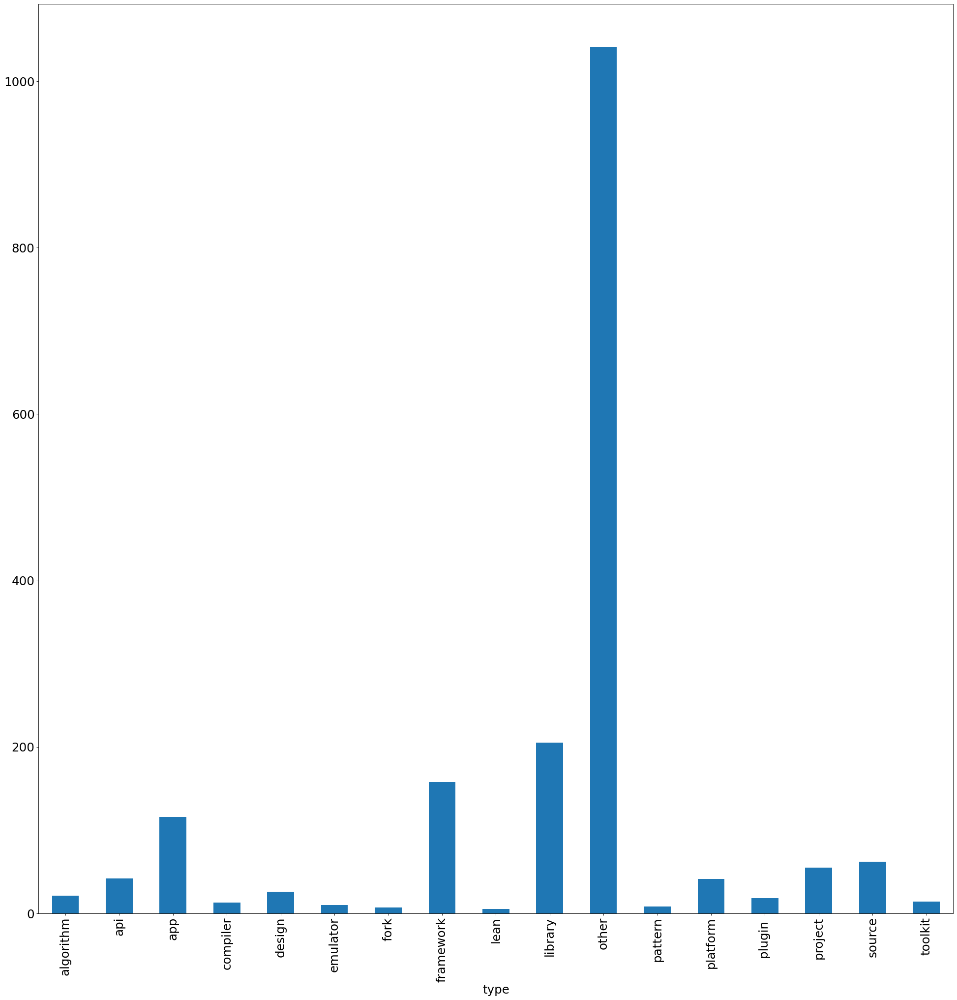

In [108]:
import matplotlib.pyplot as plt

plt.figure(figsize=(40, 20), dpi=80)
plt.rcParams.update({'font.size': 22})

fitches.groupby('type').size().plot(kind='bar', figsize = (30, 30))

In [13]:
types = open('types.txt', 'r').read().split('\n')
types

['toolkit',
 'framework',
 'library',
 'plugin ',
 'api',
 'algorithm',
 'project',
 'platform',
 'pattern',
 'fork',
 'source',
 'emulator',
 'compiler',
 'design',
 'app',
 'lean',
 'sdk',
 'other']

In [21]:
def get_type(desc):
    resp = ""
    for type_i in types[:-2]:

        if type_i.lower() in desc.lower():
            resp =  type_i
            break
        else:
            resp = 'other'
    print(desc.lower())

    return resp

fitches['type'] = fitches['description'].astype('str').apply(lambda x: get_type(x))

        a c# port of shadowsocks      
        the roslyn .net compiler provides c# and visual basic languages with rich code analysis apis.      
        experimental nintendo switch emulator written in c#      
        google's material design in xaml & wpf, for c# & vb.net.       
        open source real-time strategy game engine for early westwood games such as command & conquer: red alert written in c#…      
        mono open source ecma cli, c# and .net implementation.      
        unity c# reference source code.      
        the official repo for the design of the c# programming language      
c# application with primary purpose of farming steam cards from multiple accounts simultaneously.      
        微信全平台 sdk senparc.weixin for c#，支持 .net framework 及 .net core、.net 6.0、.net 7.0。已支持微信公众号、小程序、小游戏、微信支付、企业微信/企业号、开放平台、j…      
        build mobile, desktop and webassembly apps with c# and xaml. today. open source and professionally supported.      
        lean algorithmic tr

In [22]:
fitches['type'].value_counts()

other        1041
library       205
framework     158
app           116
source         62
project        55
api            42
platform       41
design         26
algorithm      21
plugin         18
toolkit        14
compiler       13
emulator       10
pattern         8
fork            7
lean            5
Name: type, dtype: int64

In [10]:
names = fitches['name'].apply(lambda x: x.split('/')[1]).to_numpy()

In [11]:
langs = set(fitches['language'].to_numpy())

In [32]:
langs

{'Ada',
 'BASIC',
 'C#',
 'C++',
 'ColdFusion',
 'Dart',
 'Dylan',
 'Eiffel',
 'Go',
 'Groovy',
 'Haxe',
 'Io',
 'Java',
 'Kotlin',
 'PHP',
 'Pascal',
 'Perl',
 'Pike',
 'Python',
 'Ruby',
 'Self',
 'Smalltalk',
 'Swift',
 'Vala'}

In [52]:
def get_bound(tags):
    tags = tags.split(',')
    resp = []
    for key in tags:
        for lang in langs:
            if key.lower() == lang.lower():
                resp.append(key)

        for fitcha in names:
            if key.lower() == fitcha.lower() or fitcha.lower() in key.lower():
                resp.append(key)
                
    return set(resp)

fitches['bound'] = fitches['keys'].astype('str').apply(lambda x: get_bound(x))

In [53]:
fitches['bound'].value_counts()

{}                                                                                                                               600
{vala}                                                                                                                            12
{pascal}                                                                                                                          11
{dylan}                                                                                                                           10
{hacktoberfest, vala}                                                                                                              9
                                                                                                                                ... 
{pascal, lazarus, python}                                                                                                          1
{webapp, pascal, opensource-library, compression-library, crypto-libr

In [23]:
for_graph = fitches[["name", "language"]].to_numpy()
for_graph

array([['shadowsocks/shadowsocks-windows', 'C#'],
       ['dotnet/roslyn', 'C#'],
       ['Ryujinx/Ryujinx', 'C#'],
       ...,
       ['anthony-arnold/AdaID', 'Ada'],
       ['Componolit/jwx', 'Ada'],
       ['stcarrez/ada-enet', 'Ada']], dtype=object)

In [24]:
for_graph

array([['shadowsocks/shadowsocks-windows', 'C#'],
       ['dotnet/roslyn', 'C#'],
       ['Ryujinx/Ryujinx', 'C#'],
       ...,
       ['anthony-arnold/AdaID', 'Ada'],
       ['Componolit/jwx', 'Ada'],
       ['stcarrez/ada-enet', 'Ada']], dtype=object)

In [44]:
from pyvis.network import Network
import networkx as nx

nt = Network('720px', '1280px')
nt.show_buttons()

for name in range(len(names)):
    nt.add_node(name, size=20, label = names[name], group = 1)
    
langs = list(langs)

for lang in range(len(langs)):
    nt.add_node(len(names) + lang, size=85, label = langs[lang], group = 2)

print(for_graph.T)
for node in nt.nodes:
    if node['group'] == 2:
        for lab_c in for_graph:
            if node['label'] == lab_c[1]:
#                 print(list(for_graph.T[0]).index(lab_c[0]))
                nt.add_edge(list(for_graph.T[0]).index(lab_c[0]),node['id'])

    
    
# nx_graph = nx.cycle_graph(10)
# nx_graph.nodes[1]['title'] = 'Number 1'
# nx_graph.nodes[1]['group'] = 1
# nx_graph.nodes[3]['title'] = 'I belong to a different group!'
# nx_graph.nodes[3]['group'] = 10
# nx_graph.add_node(20, size=20, title='couple', group=2)
# nx_graph.add_node(21, size=15, title='couple', group=2)
nx_graph.add_edge(20, 21, weight=5)
# nx_graph.add_node(25, size=25, label='lonely', title='lonely node', group=3)
# # populates the nodes and edges data structures
# nt.from_nx(nx_graph)
nt.show('mygraph.html')


[['shadowsocks/shadowsocks-windows' 'dotnet/roslyn' 'Ryujinx/Ryujinx' ...
  'anthony-arnold/AdaID' 'Componolit/jwx' 'stcarrez/ada-enet']
 ['C#' 'C#' 'C#' ... 'Ada' 'Ada' 'Ada']]


In [103]:
import networkx as nx
import numpy.random as rnd
import matplotlib.pyplot as plt

def add_edge(f_item, s_item, graph=None):
    graph.add_edge(f_item, s_item)
    graph.add_edge(s_item, f_item) 

graph = nx.Graph()

color_map = []
sizes = []

for name in names:
    graph.add_node(name.lower())

    
for bound in for_graph:
    graph.add_edge(bound[0].split('/')[1], bound[1], graph = graph)
    
for node in graph:
    color = 'red'
    size = 300
    for name in names:
        if node == name:
            color = 'orange'
            size = 700
            break
    for lang in langs:
        if node == lang:
            color = "blue"
            size = 2000
            break
            
    color_map.append(color)
    sizes.append(size)

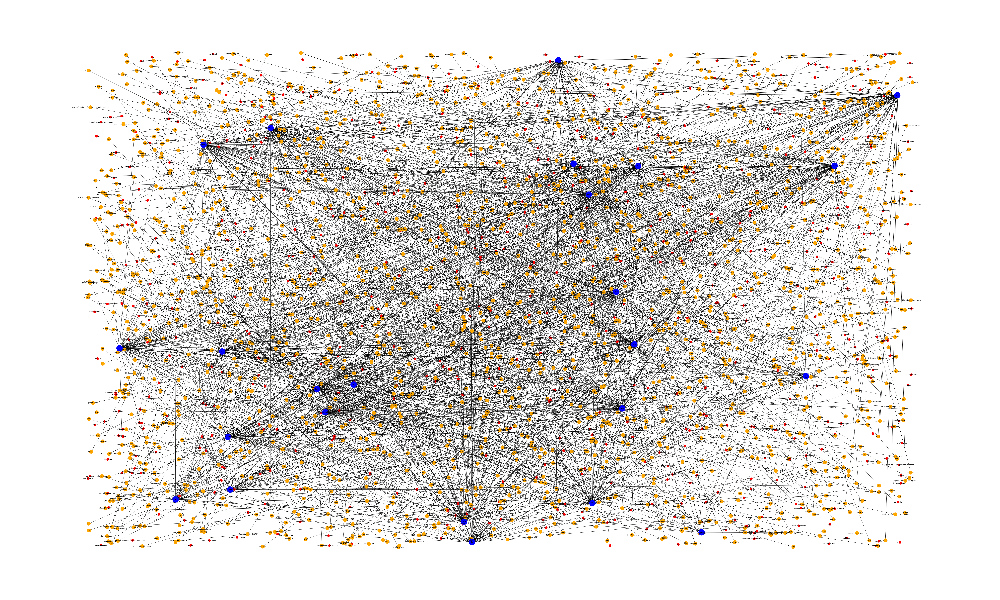

In [104]:
plt.figure(figsize=(100, 60), dpi=80)

plt.rcParams.update({'font.size': 10})

nx.draw_random(graph,
        node_color=color_map,
        node_size=sizes,

         with_labels=True)